# Capstone 2: Phishing Website Detection Model:

## Data and Data Cleaning:
The dataset for this capstone project comes from kaggle: [Kaggle Dataset](https://www.kaggle.com/shashwatwork/phishing-dataset-for-machine-learning). The data is information about 5,000 phishing websites and 5,000 non-phishing websites; around half of the columns are booleans, but some contain ints and three contain floats representing percentages. Those sorted as 'categorical' below actually contain one of three values (-1, 0, 1). All of the columns are numerical. On the first run-through, the "categorical" features were one-hot encoded, but this yielded worse results in terms of accuracy than leaving these features as they were.
Below, an extraneous id column and a column that only contained one value ('HttpsInHostname'), are dropped from the dataset. Then, the y column specifying class is defined, as are the x columns containing the remainder of the dataset. The x data is then scaled.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import sklearn.cluster
import numpy as np
import sklearn.metrics
import matplotlib.cm as cm
import sklearn.decomposition
import matplotlib.colors
from IPython.display import Image

data = pd.read_csv('phishing_data.csv')
nefarious = data[data['CLASS_LABEL'] == 0] #Class one, I believe, describes phishing websites; '0' corresponds to 
#'False' and the original csv was named 'Legitimate websites' - This is my reasoning
non_nefarious = data[data['CLASS_LABEL'] == 1]

#The following are categorizations of the various features both for clarity and for use in modeling and visualization.
categorical = ['SubdomainLevelRT', 'UrlLengthRT', 'PctExtResourceUrlsRT', 'AbnormalExtFormActionR', 'ExtMetaScriptLinkRT', 
               'PctExtNullSelfRedirectHyperlinksRT'] #changed - now just the '-1, 0, 1' columns.
binary = ['AtSymbol', 'TildeSymbol', 'NumHash', 'NoHttps' 'RandomString', 'IpAddress', 'DomainInSubdomains', 
          'DomainInPaths', 'DoubleSlashInPath', 'EmbeddedBrandName', 'ExtFavicon', 'InsecureForms', 
          'RelativeFormAction', 'ExtFormAction', 'AbnormalFormAction', 'FrequentDomainNameMismatch',
          'FakeLinkInStatusBar', 'RightClickDisabled', 'PopUpWindow','SubmitInfoToEmail', 'IframeOrFrame', 
          'MissingTitle', 'ImagesOnlyInForm','CLASS_LABEL']
percentages = ['PctNullSelfRedirectHyperlinks', 'PctExtHyperlinks', 'PctExtResourceUrls'] 

#The following important_array features the columns which were identified as most important for sorting nefarious 
#from non-nefarious websites, in order of importance starting with the most important (with 'CLASS_LABEL' added for
#clarity only):
important_array = ['PctExtHyperlinks','PctExtNullSelfRedirectHyperlinksRT','FrequentDomainNameMismatch','PctExtResourceUrls', 'PctNullSelfRedirectHyperlinks', 'NumDash', 
                   'CLASS_LABEL'] 

#Note: Below is the code that would one-hot-encode the categorical columns (those which are split into [1,0,-1] in 
#this case). I ran the entire set of models using the one-hot encoding data, but this approach actually returned worse
#results on most models that the [1,0,-1] approacj. For this reason, the code is here, but it is not actually the data
#that's used in the prediction model.
one_hot_data = pd.get_dummies(data, columns=categorical)

#I identified two columns to be dropped completely: id and HttpsInHostname.
data = data.drop(['id','HttpsInHostname'], axis=1) #Note: entering 'one_hot_data.drop' here would run the models with 
                                                    #that data instead.
data_columns = data.columns
X = data.drop(['CLASS_LABEL'],axis =1)
X_cols = X.columns
y = data['CLASS_LABEL']
y_col = 'CLASS_LABEL'
scaler = StandardScaler().fit(X)
X_scaled = scaler.transform(X)
#The above is only the fit and transformation for the unsupervised trial - redone below for test/train split

## EDA:
Below are breakdowns via histogram (broken up by nefarious and non-nefariou class) and violinplot of the six most important columns to the random forest prediction model which follows in the modeling stage. The columns in question are'PctExtHyperlinks', 'PctExtNullSelfRedirectHyperlinksRT', 'FrequentDomainNameMismatch', 'PctExtResourceUrls', 'PctNullSelfRedirectHyperlinks', and 'NumDash'. Their breakdowns, below, help visualize how these categories vary depending on the nefarious or non-nefarious nature of the website. Interestingly, the top two most important features and the fourth most important feature are the three float categories representing percentages. This possibily indicates the overall importance of calculating percentages in order to gain an understanding of the nature of a website.

<AxesSubplot:ylabel='Frequency'>

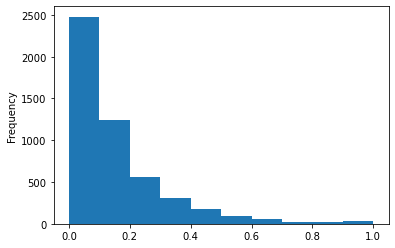

In [2]:
#When the feature importances are charted further below, you will see that the three percentage features, noted in an 
#array of three above (these are the three floats), each rank within the top five important features for the model
#categorization.
#Those features are plotted as histograms below, broken up into nefarious and non-nefarious categories.
#First, the most important feature is the Percent of External Hyperlinks:
nefarious['PctExtHyperlinks'].plot.hist()

<AxesSubplot:ylabel='Frequency'>

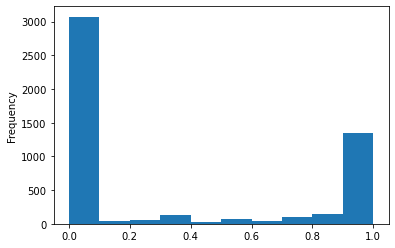

In [3]:
non_nefarious['PctExtHyperlinks'].plot.hist()

<AxesSubplot:xlabel='CLASS_LABEL', ylabel='PctExtHyperlinks'>

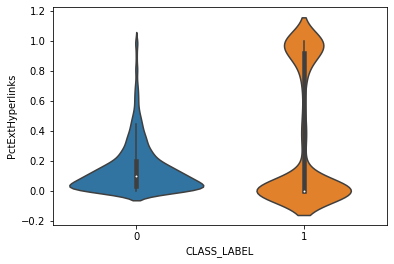

In [4]:
sns.violinplot(data=data, x='CLASS_LABEL',y=important_array[0])

<AxesSubplot:ylabel='Frequency'>

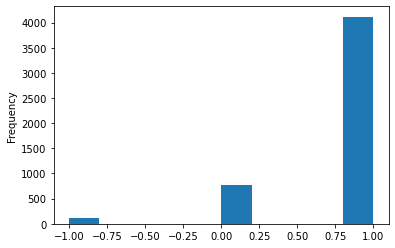

In [5]:
nefarious['PctExtNullSelfRedirectHyperlinksRT'].plot.hist()

<AxesSubplot:ylabel='Frequency'>

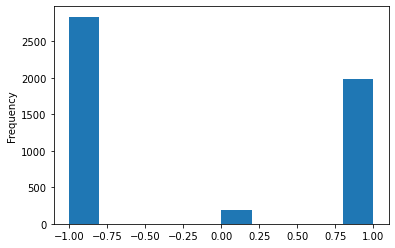

In [6]:
non_nefarious['PctExtNullSelfRedirectHyperlinksRT'].plot.hist()

<AxesSubplot:xlabel='CLASS_LABEL', ylabel='PctExtNullSelfRedirectHyperlinksRT'>

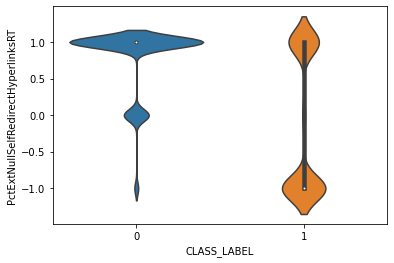

In [7]:
sns.violinplot(data=data, x='CLASS_LABEL',y=important_array[1])

<AxesSubplot:ylabel='Frequency'>

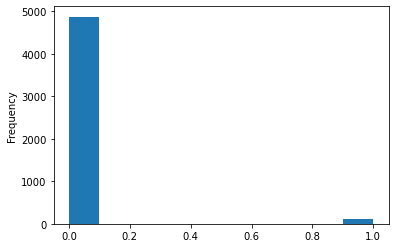

In [8]:
nefarious['FrequentDomainNameMismatch'].plot.hist()

<AxesSubplot:ylabel='Frequency'>

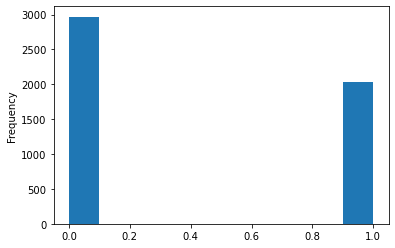

In [9]:
non_nefarious['FrequentDomainNameMismatch'].plot.hist()

<AxesSubplot:xlabel='CLASS_LABEL', ylabel='FrequentDomainNameMismatch'>

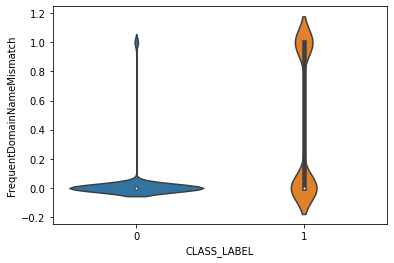

In [10]:
sns.violinplot(data=data, x='CLASS_LABEL',y=important_array[2])

<AxesSubplot:ylabel='Frequency'>

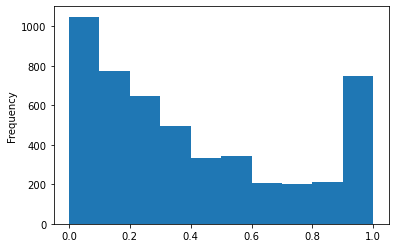

In [11]:
nefarious['PctExtResourceUrls'].plot.hist()

<AxesSubplot:ylabel='Frequency'>

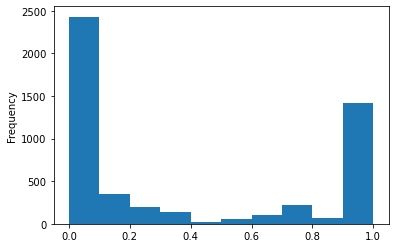

In [12]:
non_nefarious['PctExtResourceUrls'].plot.hist()

<AxesSubplot:xlabel='CLASS_LABEL', ylabel='PctExtResourceUrls'>

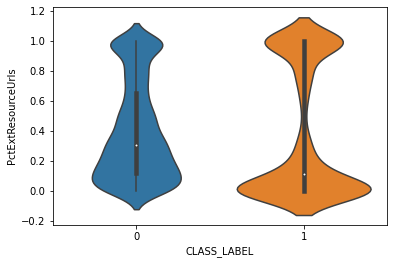

In [13]:
sns.violinplot(data=data, x='CLASS_LABEL',y=important_array[3])

<AxesSubplot:ylabel='Frequency'>

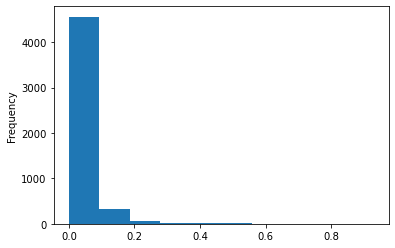

In [14]:
nefarious['PctNullSelfRedirectHyperlinks'].plot.hist()

<AxesSubplot:ylabel='Frequency'>

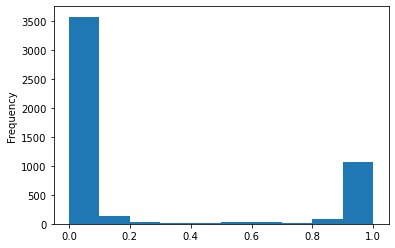

In [15]:
non_nefarious['PctNullSelfRedirectHyperlinks'].plot.hist()

<AxesSubplot:xlabel='CLASS_LABEL', ylabel='PctNullSelfRedirectHyperlinks'>

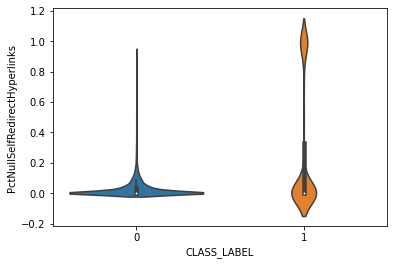

In [16]:
sns.violinplot(data=data, x='CLASS_LABEL',y=important_array[4])

<AxesSubplot:ylabel='Frequency'>

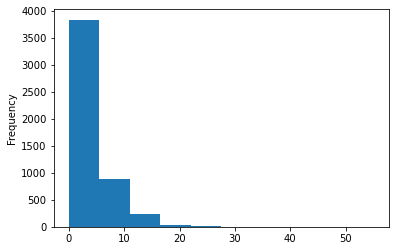

In [17]:
nefarious['NumDash'].plot.hist()

<AxesSubplot:ylabel='Frequency'>

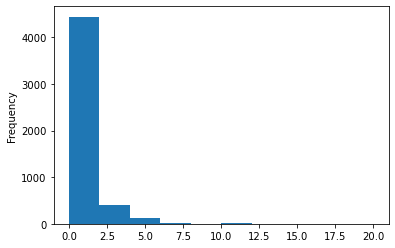

In [18]:
non_nefarious['NumDash'].plot.hist()

<AxesSubplot:xlabel='CLASS_LABEL', ylabel='NumDash'>

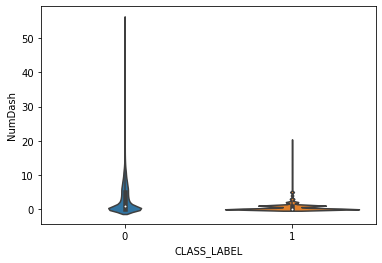

In [19]:
sns.violinplot(data=data, x='CLASS_LABEL',y=important_array[5])

<AxesSubplot:>

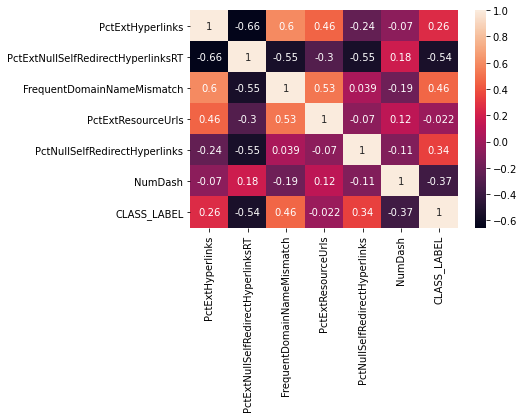

In [20]:
sns.heatmap(data[important_array].corr(), annot=True)

## Modeling:
Six different models were run on this dataset, some using the grid search method to tune parameters and one using bayesian optimization to tune parameters. These models are, in order: Random Forest, KNN, a Decision Tree using Entropy, a Decision Tree using Gini, a Gradient Boosting Classifier, and a Light Gradient Boosting Model. The accuracy, balanced accuracy, precision score and recall score are gathered for each model based on its predictions about the data. Ultimately, the Random Forest model, on which a grid search is used to fine-tune parameters, and the Light Gradient Boosting model, on which a Bayesian Optimization is used to fine-tune parameters, outperform the others.

In [21]:
#Random Forest Model:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,roc_auc_score, f1_score, accuracy_score,log_loss, auc

#Test train split is performed on the variables before they've been scaled so that X_test can be transformed after the 
#scaler has been fit for X_train (so that the testing data is not a factor, to prevent leakage) 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=1)
scaler = StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

param_grid = {'n_estimators':np.arange(1,500,50)}
rfc = RandomForestClassifier()
rfc_cv= GridSearchCV(rfc,param_grid,cv=5)
rfc_cv.fit(X_train_scaled, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'n_estimators': array([  1,  51, 101, 151, 201, 251, 301, 351, 401, 451])})

In [22]:
#Below are the best scores achieved by the Random Forest Model, using a Grid Search to find the best parameters:
print("Best Score:" + str(rfc_cv.best_score_))
print("Best Parameters: " + str(rfc_cv.best_params_))

Best Score:0.98425
Best Parameters: {'n_estimators': 201}


In [24]:
#Below, the Random Forest Classifier is run again with the optimal parameter found above - for visualization purposes
model = RandomForestClassifier(n_estimators=201)

# Train
model.fit(X_train_scaled, y_train)
# Extract single tree
estimator = model.estimators_[5]

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X_cols,
                class_names = y_col,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook - this is imported at the top
Image(filename = 'tree.png')

Random Forest: Accuracy=0.982
Further Random Forest Metrics:
Balanced accuracy: 0.9815023425330571
Precision score: 0.9823529411764705
Recall score: 0.9813907933398629


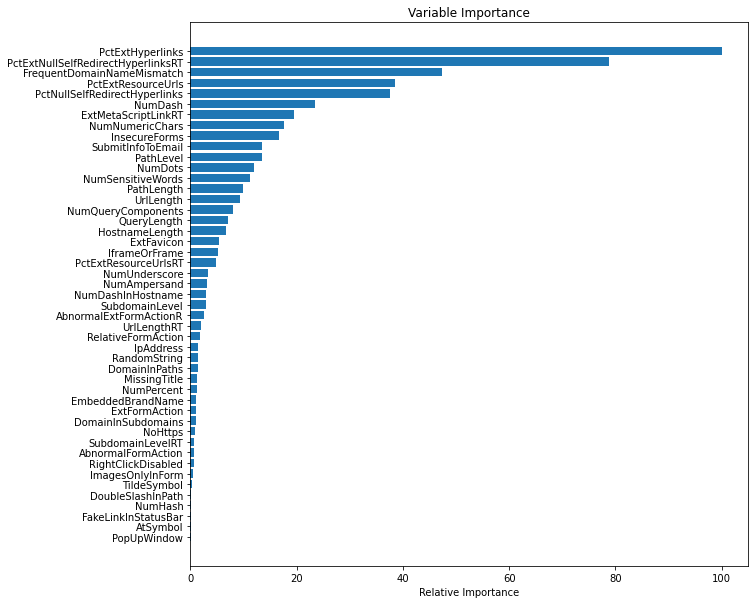

In [26]:
#Metrics for the Random Forest Classifier Model:
#NOTE: The number of recommended estimators changes every time it's run, so this is approximate and subject to change.
from sklearn import tree, metrics
clf = RandomForestClassifier(n_estimators=201)
model_res = clf.fit(X_train_scaled, y_train)
y_pred = model_res.predict(X_test_scaled)

ac = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
cm = confusion_matrix(y_test, y_pred)

print('Random Forest: Accuracy=%.3f' % (ac))
#print('Random Forest: f1-score=%.3f' % (f1)) - same as accuracy score, above
print('Further Random Forest Metrics:')
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score:' , metrics.precision_score(y_test,y_pred))
print('Recall score:' , metrics.recall_score(y_test,y_pred))

feature_importance = clf.feature_importances_
# make importances relative to max importance
feature_importance = 100.0 * (feature_importance / feature_importance.max())#[:48]
sorted_idx = np.argsort(feature_importance)#[:48]

pos = np.arange(sorted_idx.shape[0]) + .5
#print(pos.size)
sorted_idx.size
plt.figure(figsize=(10,10))
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, X.columns[sorted_idx])
plt.xlabel('Relative Importance')
plt.title('Variable Importance')
plt.show()

In [27]:
#KNN Model Run Through a Grid Search:
from sklearn.neighbors import KNeighborsClassifier
param_grid = {'n_neighbors':np.arange(1,50)}
knn = KNeighborsClassifier()
knn_cv= GridSearchCV(knn,param_grid,cv=5)
knn_cv.fit(X_train_scaled, y_train)
#Shorted list of metrics for the K Nearest Neighbors Model, based on Grid Search:
print("Best Score:" + str(knn_cv.best_score_))
print("Best Parameters: " + str(knn_cv.best_params_))
#Note: The "elbow method" visualization for KNN was tried in modeling, but as the lowest accuracy score is still
#lower than those found elsewhere, this grid search result (plus the metrics below) is sufficient to move on from KNN.

Best Score:0.9536250000000001
Best Parameters: {'n_neighbors': 1}


In [28]:
neigh = KNeighborsClassifier(n_neighbors=1)
neigh.fit(X_train_scaled, y_train)
y_pred = neigh.predict(X_test_scaled)
print("KNN model:")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score:', metrics.precision_score(y_test,y_pred))
print('Recall score:', metrics.recall_score(y_test,y_pred))

KNN model:
Accuracy: 0.9625
Balanced accuracy: 0.962451941306116
Precision score: 0.9619140625
Recall score: 0.9647404505386875


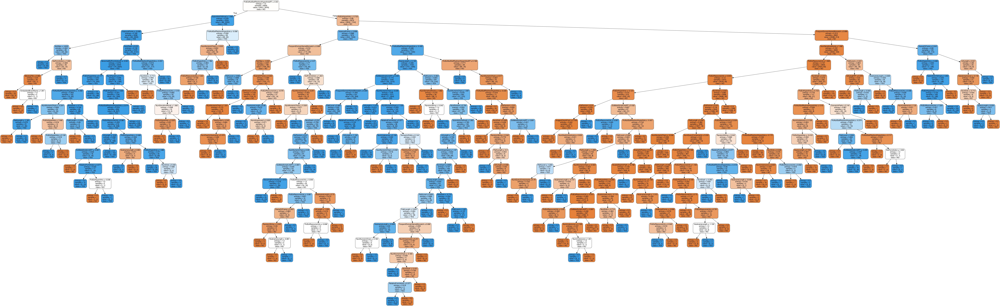

In [29]:
#Because the Best Score (Accuracy) of KNN is not better than the best score of Random Forest, A Better Model is Sought:
#Below is the Decision tree Classifier Model, using Entropy:
from sklearn import tree, metrics
import seaborn as sns
from io import StringIO  
from IPython.display import Image  
import pydotplus

entr_model = tree.DecisionTreeClassifier(criterion="entropy", random_state = 1234)
entr_model.fit(X_train_scaled, y_train)

y_pred = entr_model.predict(X_test_scaled)

y_pred = pd.Series(y_pred)

dot_data = StringIO()

#Export_graphviz is used to visualize the model:
tree.export_graphviz(entr_model, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_cols,class_names = ["NO","YES"]) 

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

In [30]:
#Below, the Metrics for the Entropy Decision Tree Model, based on the prediction compared to the y_test value:
#Note: No Max Depth has been set:
print("Model Entropy - no max depth")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score:' , metrics.precision_score(y_test,y_pred))
print('Recall score:' , metrics.recall_score(y_test,y_pred))

Model Entropy - no max depth
Accuracy: 0.9625
Balanced accuracy: 0.9623468949806865
Precision score: 0.9574468085106383
Recall score: 0.9696376101860921


In [31]:
#Below, a Gini Decision Tree Model is attempted, and the metrics printed based on its prediction.
gini_model = tree.DecisionTreeClassifier(criterion="gini", random_state = 1234) 
gini_model.fit(X_train_scaled, y_train)

y_pred = gini_model.predict(X_test_scaled)

y_pred = pd.Series(y_pred)

dot_data = StringIO()
tree.export_graphviz(gini_model, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names=X_cols,class_names = ["NO", "YES"])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
print("Model Gini impurity model")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score for:' , metrics.precision_score(y_test,y_pred))
print('Recall score:' , metrics.recall_score(y_test,y_pred))

Model Gini impurity model
Accuracy: 0.9655
Balanced accuracy: 0.9655162926850741
Precision score for: 0.9675834970530451
Recall score: 0.9647404505386875


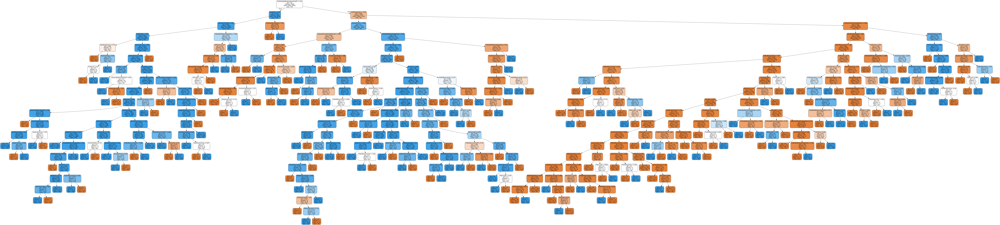

In [32]:
#The gini model is graphed below, but its accuracy, along with that of the entropy model, is below what was achieved
#with Random Forest.
Image(graph.create_png())

In [33]:
#Gradient Boosting:
from sklearn.ensemble import GradientBoostingClassifier
learning_rates = [0.05, 0.1, 0.25, 0.5, 0.75, 1]
for learning_rate in learning_rates:
    gb = GradientBoostingClassifier(n_estimators=20, learning_rate = learning_rate, max_features=2, max_depth = 2, random_state = 0)
    gb.fit(X_train_scaled, y_train)
   # print("Learning rate: ", learning_rate)
   # print("Accuracy score (training): {0:.3f}".format(gb.score(X_train_scaled, y_train)))
   # print("Accuracy score (validation): {0:.3f}".format(gb.score(X_test_scaled, y_test)))
   # print()
    
gb = GradientBoostingClassifier(n_estimators=20, learning_rate = 1, max_features=2, max_depth = 2, random_state = 0)
gb.fit(X_train_scaled, y_train)
y_pred = gb.predict(X_test_scaled)
print("Confusion matrix: ", confusion_matrix(y_test, y_pred))
print("Classification report: ", classification_report(y_test, y_pred))

y_scores_gb = gb.decision_function(X_test_scaled)
fpr_gb, tpr_gb, _ = roc_curve(y_test, y_scores_gb)
roc_auc_gb = auc(fpr_gb, tpr_gb)
print("Area under ROC: ", roc_auc_gb)

Confusion matrix:  [[929  50]
 [ 42 979]]
Classification report:                precision    recall  f1-score   support

           0       0.96      0.95      0.95       979
           1       0.95      0.96      0.96      1021

    accuracy                           0.95      2000
   macro avg       0.95      0.95      0.95      2000
weighted avg       0.95      0.95      0.95      2000

Area under ROC:  0.9861653989409329


In [34]:
print("Gradient Boosting Model:")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred, pos_label = 1))
print('Recall score' , metrics.recall_score(y_test,y_pred, pos_label = 0))

Gradient Boosting Model:
Accuracy: 0.954
Balanced accuracy: 0.9538956679895834
Precision score 0.9514091350826045
Recall score 0.9489274770173647


In [35]:
#Finally, a Baysian model:
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder
import lightgbm
from bayes_opt import BayesianOptimization
from catboost import CatBoostClassifier, cv, Pool
import os
def lgb_eval(num_leaves,max_depth,lambda_l2,lambda_l1,min_child_samples, min_data_in_leaf):
    params = {
        "objective" : "binary",
        "metric" : "auc", 
        'is_unbalance': True,
        "num_leaves" : int(num_leaves),
        "max_depth" : int(max_depth),
        "lambda_l2" : lambda_l2,
        "lambda_l1" : lambda_l1,
        "num_threads" : 20,
        "min_child_samples" : int(min_child_samples),
        'min_data_in_leaf': int(min_data_in_leaf),
        "learning_rate" : 0.03,
        "subsample_freq" : 5,
        "bagging_seed" : 42,
        "verbosity" : -1
    }
    lgtrain = lightgbm.Dataset(X_train_scaled, y_train)
    cv_result = lightgbm.cv(params,
                       lgtrain,
                       1000,
                       early_stopping_rounds=100,
                       stratified=True,
                       nfold=3)
    return cv_result['auc-mean'][-1]

lgbBO = BayesianOptimization(lgb_eval, {'num_leaves': (25, 4000),
                                                'max_depth': (5, 63),
                                                'lambda_l2': (0.0, 0.05),
                                                'lambda_l1': (0.0, 0.05),
                                                'min_child_samples': (50, 10000),
                                                'min_data_in_leaf': (100, 2000)
                                                })

lgbBO.maximize(n_iter=10, init_points=2)

|   iter    |  target   | lambda_l1 | lambda_l2 | max_depth | min_ch... | min_da... | num_le... |
-------------------------------------------------------------------------------------------------
[LightGBM] [Warning] min_data_in_leaf is set=1522, min_child_samples=3080 will be ignored. Current value: min_data_in_leaf=1522
|  1        |  0.9832   |  0.03528  |  0.0327   |  51.05    |  3.08e+03 |  1.523e+0 |  1.563e+0 |
|  2        |  0.9984   |  0.007343 |  0.02798  |  56.18    |  5.96e+03 |  104.9    |  3.486e+0 |
|  3        |  0.9666   |  0.03044  |  0.00409  |  35.33    |  2.114e+0 |  1.896e+0 |  2.11e+03 |
|  4        |  0.9639   |  0.04286  |  0.002471 |  5.398    |  2.561e+0 |  1.938e+0 |  3.506e+0 |
|  5        |  0.9642   |  0.03448  |  0.007393 |  26.27    |  8.857e+0 |  1.936e+0 |  1.053e+0 |
|  6        |  0.9809   |  0.02297  |  0.0114   |  51.35    |  5.327e+0 |  1.606e+0 |  2.487e+0 |
|  7        |  0.9982   |  0.0482   |  0.02544  |  56.13    |  6.84e+03 |  286.6    |  3

In [36]:
print(lgbBO.max)
params = lgbBO.max['params']
#The 'target' value is effectively grading the performance of the model, not telling us
#the model metrics here. For that, we need to run the lgbm model using the found parameters (as was done above for KNN
#and Random Forest after the grid searches).

{'target': 0.9984637068538224, 'params': {'lambda_l1': 0.02516360424484215, 'lambda_l2': 0.011371325410784762, 'max_depth': 13.070278174084402, 'min_child_samples': 9747.939677118613, 'min_data_in_leaf': 209.64831358427148, 'num_leaves': 3977.2102057031148}}


In [37]:
#Using these parameters to find more precise metrics for the lgb model:
train_data = lightgbm.Dataset(X_train_scaled, label=y_train)
test_data = lightgbm.Dataset(X_test_scaled, label=y_test)
params['num_leaves'] = int(params['num_leaves'])
params['max_depth'] = int(params['max_depth'])
params['min_data_in_leaf'] = int(params['min_data_in_leaf'])
params['application'] = 'binary'
params['objective'] = 'binary'
params['metric'] = 'auc'
params['is_unbalance'] = True
params['num_threads'] = 20
params['learning_rate'] = 0.03
params['subsample_freq'] = 5
params['bagging_seed'] = 42
params['verbosity'] = -1
#print(params)
model = lightgbm.train(params,
                       train_data,
                       valid_sets=test_data,
                       num_boost_round=5000,
                       early_stopping_rounds=100)
model.save_model('model.txt')

[1]	valid_0's auc: 0.973702
Training until validation scores don't improve for 100 rounds
[2]	valid_0's auc: 0.973458
[3]	valid_0's auc: 0.973957
[4]	valid_0's auc: 0.973537
[5]	valid_0's auc: 0.975174
[6]	valid_0's auc: 0.975
[7]	valid_0's auc: 0.975399
[8]	valid_0's auc: 0.975357
[9]	valid_0's auc: 0.975453
[10]	valid_0's auc: 0.975458
[11]	valid_0's auc: 0.975381
[12]	valid_0's auc: 0.975392
[13]	valid_0's auc: 0.975427
[14]	valid_0's auc: 0.975417
[15]	valid_0's auc: 0.975347
[16]	valid_0's auc: 0.976564
[17]	valid_0's auc: 0.976476
[18]	valid_0's auc: 0.976378
[19]	valid_0's auc: 0.97629
[20]	valid_0's auc: 0.976263
[21]	valid_0's auc: 0.976515
[22]	valid_0's auc: 0.97668
[23]	valid_0's auc: 0.976632
[24]	valid_0's auc: 0.976556
[25]	valid_0's auc: 0.976567
[26]	valid_0's auc: 0.976506
[27]	valid_0's auc: 0.976712
[28]	valid_0's auc: 0.976613
[29]	valid_0's auc: 0.976885
[30]	valid_0's auc: 0.977227
[31]	valid_0's auc: 0.977302
[32]	valid_0's auc: 0.977197
[33]	valid_0's auc: 0.97

[287]	valid_0's auc: 0.998404
[288]	valid_0's auc: 0.99841
[289]	valid_0's auc: 0.99842
[290]	valid_0's auc: 0.998413
[291]	valid_0's auc: 0.998419
[292]	valid_0's auc: 0.998429
[293]	valid_0's auc: 0.998446
[294]	valid_0's auc: 0.998447
[295]	valid_0's auc: 0.998444
[296]	valid_0's auc: 0.99846
[297]	valid_0's auc: 0.998461
[298]	valid_0's auc: 0.998462
[299]	valid_0's auc: 0.998469
[300]	valid_0's auc: 0.998472
[301]	valid_0's auc: 0.99848
[302]	valid_0's auc: 0.998485
[303]	valid_0's auc: 0.998487
[304]	valid_0's auc: 0.998496
[305]	valid_0's auc: 0.998496
[306]	valid_0's auc: 0.998501
[307]	valid_0's auc: 0.99851
[308]	valid_0's auc: 0.998517
[309]	valid_0's auc: 0.998516
[310]	valid_0's auc: 0.998524
[311]	valid_0's auc: 0.998528
[312]	valid_0's auc: 0.998523
[313]	valid_0's auc: 0.998524
[314]	valid_0's auc: 0.99854
[315]	valid_0's auc: 0.998544
[316]	valid_0's auc: 0.998545
[317]	valid_0's auc: 0.998544
[318]	valid_0's auc: 0.99855
[319]	valid_0's auc: 0.998553
[320]	valid_0's a

[563]	valid_0's auc: 0.999084
[564]	valid_0's auc: 0.999079
[565]	valid_0's auc: 0.999082
[566]	valid_0's auc: 0.999079
[567]	valid_0's auc: 0.999075
[568]	valid_0's auc: 0.999076
[569]	valid_0's auc: 0.999081
[570]	valid_0's auc: 0.999085
[571]	valid_0's auc: 0.999079
[572]	valid_0's auc: 0.999085
[573]	valid_0's auc: 0.999082
[574]	valid_0's auc: 0.999083
[575]	valid_0's auc: 0.999081
[576]	valid_0's auc: 0.99908
[577]	valid_0's auc: 0.999083
[578]	valid_0's auc: 0.999083
[579]	valid_0's auc: 0.999079
[580]	valid_0's auc: 0.999079
[581]	valid_0's auc: 0.99908
[582]	valid_0's auc: 0.999083
[583]	valid_0's auc: 0.999082
[584]	valid_0's auc: 0.999077
[585]	valid_0's auc: 0.999079
[586]	valid_0's auc: 0.999078
[587]	valid_0's auc: 0.99908
[588]	valid_0's auc: 0.999075
[589]	valid_0's auc: 0.999079
[590]	valid_0's auc: 0.999084
[591]	valid_0's auc: 0.999079
[592]	valid_0's auc: 0.999081
[593]	valid_0's auc: 0.999084
[594]	valid_0's auc: 0.999088
[595]	valid_0's auc: 0.999091
[596]	valid_0

In [42]:
y_pred = model.predict(X_test_scaled, num_iteration=model.best_iteration)
y_pred = y_pred.round(0)
#print(y_pred)

In [45]:
#The best of the models previous to the Baysian Optimization model was the Random Forest Model, 
#but model shows an improvement in all four of the metrics being monitored.
print("Light GBM with Bayesian Parameter Tuning:")
print("Accuracy:", metrics.accuracy_score(y_test,y_pred))
print("Balanced accuracy:", metrics.balanced_accuracy_score(y_test,y_pred))
print('Precision score' , metrics.precision_score(y_test,y_pred))
print('Recall score' , metrics.recall_score(y_test,y_pred))

Light GBM with Bayesian Parameter Tuning:
Accuracy: 0.9855
Balanced accuracy: 0.9854620887811525
Precision score 0.984375
Recall score 0.9872673849167483


## Predictions:
The metrics of each model's predictions have been compiled in the graph below.

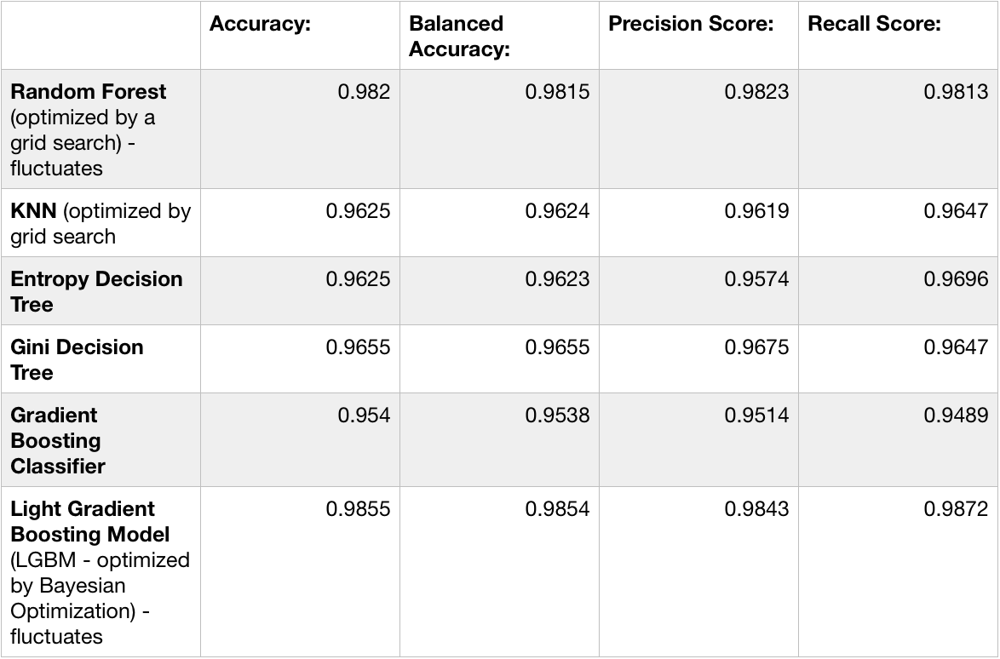

In [46]:
Image('model_metrics.png')

## Choosing Between Two High-Performing Models:
We can see above that the Random Forest Model and the Light BGM Model perform very similarly in terms of predictive ability. For this project, I believe it's most important to find a model with a high recall score due to the damage that can be caused by uncaught phishing websites (false negatives). The only additional concern is the computation time needed for this model. Given the overall preferability of the LGBM in terms of metrics, I still believe it is the best choice.